In [1]:
# Import libraries
import pandas as pd
import numpy as np
import math
import json
import matplotlib.pyplot as plt
import seaborn as sns
import pickle
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.ensemble import BaggingClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import RidgeClassifier
from sklearn.linear_model import SGDClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.metrics import make_scorer
from sklearn.model_selection import GridSearchCV
from scipy import stats
from scipy import interpolate
import re
from sklearn.preprocessing import MultiLabelBinarizer

In [2]:
from sklearn.preprocessing import StandardScaler
from sklearn.utils import check_random_state
from sklearn.decomposition import PCA

In [3]:
# Set image parameters for the notebook
plt.rcParams['figure.figsize'] = [5, 5]
sns.set_style("white")

# Set a color palette
starbucks_colr = ["#00704A", "#362415", "#eac784", "#604c4c"]

In [4]:
# Remove column display limits
pd.set_option('display.max_columns', None)
# pd.set_option('display.height', None)
pd.set_option('display.max_rows', None)
# pd.set_option('display.width', None)


## Non Standardized Data 
**Read Non-transformed merged data and remove columns like time, offer_id which is redudtant for the analysis 

In [5]:
# Read clean data
starbucks = pd.read_csv('starbucks.csv',index_col='customer_id')

# Print
starbucks.head()

C:\Users\rsure\anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3063: DtypeWarning: Columns (2) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


,Unnamed: 0,offer_id,offer_received,received_time,offer_viewed,viewed_time,time_viewed_received,offer_completed,completed_time,time_completed_received,time_completed_viewed,transaction,transaction_time,amount,total_reward,age,income,male,membership_days,reward_each_time,difficulty,duration,email,mobile,social,web,bogo,discount,informational
customer_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
ffff82501cea40309d5fdd7edcca4a07,0,fafdcd668e3743c1bb461111dcafc2a4,1,0.0,1.0,6.0,6.0,1.0,60.0,60.0,54.0,1.0,60.0,16.06,2.0,45,62000.0,0,608,2.0,10.0,10.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0
fff8957ea8b240a6b5e634b6ee8eafcf,1,fafdcd668e3743c1bb461111dcafc2a4,1,408.0,1.0,432.0,24.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,71,56000.0,1,158,2.0,10.0,10.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0
fff7576017104bcc8677a8d63322b5e1,2,fafdcd668e3743c1bb461111dcafc2a4,1,252.0,1.0,273.0,21.0,1.0,393.0,141.0,120.0,1.0,393.0,14.00,4.0,71,73000.0,1,268,2.0,10.0,10.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0
fff3ba4757bd42088c044ca26d73817a,3,fafdcd668e3743c1bb461111dcafc2a4,1,0.0,1.0,6.0,6.0,1.0,6.0,6.0,0.0,1.0,6.0,20.98,2.0,69,83000.0,0,1040,2.0,10.0,10.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0
fff29fb549084123bd046dbc5ceb4faa,4,fafdcd668e3743c1bb461111dcafc2a4,1,168.0,1.0,168.0,0.0,1.0,168.0,0.0,0.0,1.0,168.0,15.16,2.0,59,93000.0,0,329,2.0,10.0,10.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0


In [6]:
starbucks.shape

(147508, 29)

In [7]:
starbucks.dtypes

Unnamed: 0                   int64
offer_id                    object
offer_received               int64
received_time              float64
offer_viewed               float64
viewed_time                float64
time_viewed_received       float64
offer_completed            float64
completed_time             float64
time_completed_received    float64
time_completed_viewed      float64
transaction                float64
transaction_time           float64
amount                     float64
total_reward               float64
age                          int64
income                     float64
male                         int64
membership_days              int64
reward_each_time           float64
difficulty                 float64
duration                   float64
email                      float64
mobile                     float64
social                     float64
web                        float64
bogo                       float64
discount                   float64
informational       

In [8]:
starbucks_final = starbucks.drop([ 'Unnamed: 0', 'offer_id','received_time','viewed_time','completed_time','time_viewed_received','time_completed_received','time_completed_viewed'], axis = 1)
starbucks_final.dtypes

offer_received        int64
offer_viewed        float64
offer_completed     float64
transaction         float64
transaction_time    float64
amount              float64
total_reward        float64
age                   int64
income              float64
male                  int64
membership_days       int64
reward_each_time    float64
difficulty          float64
duration            float64
email               float64
mobile              float64
social              float64
web                 float64
bogo                float64
discount            float64
informational       float64
dtype: object

## Standardized Data 
**Read transformed/standardized merged data and remove columns like time, offer_id which is redudtant for the analysis 

In [9]:
# Read clean data
starbucks_std = pd.read_csv('starbucks_standarlized.csv',index_col='customer_id')

# Print
starbucks_std.head()

C:\Users\rsure\anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3063: DtypeWarning: Columns (2) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


,Unnamed: 0,offer_id,offer_received,offer_viewed,time_viewed_received,offer_completed,time_completed_received,time_completed_viewed,transaction,amount,total_reward,age,income,male,membership_days,reward_each_time,difficulty,duration,email,mobile,social,web,bogo,discount,informational
customer_id,,,,,,,,,,,,,,,,,,,,,,,,,
ffff82501cea40309d5fdd7edcca4a07,0,fafdcd668e3743c1bb461111dcafc2a4,1,1.0,-0.054744,1.0,1.297187,1.610609,1.0,0.130679,0.326225,-0.430855,0.013855,0,0.017615,0.154308,1.42297,2.224767,1.0,1.0,1.0,1.0,0.0,1.0,0.0
fff8957ea8b240a6b5e634b6ee8eafcf,1,fafdcd668e3743c1bb461111dcafc2a4,1,1.0,0.612758,0.0,-0.316558,-0.180830,0.0,-0.392544,-0.376330,1.019811,-0.275748,1,-0.995737,0.154308,1.42297,2.224767,1.0,1.0,1.0,1.0,0.0,1.0,0.0
fff7576017104bcc8677a8d63322b5e1,2,fafdcd668e3743c1bb461111dcafc2a4,1,1.0,0.501507,1.0,3.475742,3.800146,1.0,0.063566,1.028780,1.019811,0.544795,1,-0.748029,0.154308,1.42297,2.224767,1.0,1.0,1.0,1.0,0.0,1.0,0.0
fff3ba4757bd42088c044ca26d73817a,3,fafdcd668e3743c1bb461111dcafc2a4,1,1.0,-0.054744,1.0,-0.155183,-0.180830,1.0,0.290969,0.326225,0.908222,1.027467,0,0.990433,0.154308,1.42297,2.224767,1.0,1.0,1.0,1.0,0.0,1.0,0.0
fff29fb549084123bd046dbc5ceb4faa,4,fafdcd668e3743c1bb461111dcafc2a4,1,1.0,-0.277245,1.0,-0.316558,-0.180830,1.0,0.101358,0.326225,0.350273,1.510139,0,-0.610663,0.154308,1.42297,2.224767,1.0,1.0,1.0,1.0,0.0,1.0,0.0


In [10]:
starbucks_std.dtypes

Unnamed: 0                   int64
offer_id                    object
offer_received               int64
offer_viewed               float64
time_viewed_received       float64
offer_completed            float64
time_completed_received    float64
time_completed_viewed      float64
transaction                float64
amount                     float64
total_reward               float64
age                        float64
income                     float64
male                         int64
membership_days            float64
reward_each_time           float64
difficulty                 float64
duration                   float64
email                      float64
mobile                     float64
social                     float64
web                        float64
bogo                       float64
discount                   float64
informational              float64
dtype: object

In [11]:
starbucks_std_final = starbucks_std.drop([ 'Unnamed: 0', 'offer_id','time_viewed_received','time_completed_received','time_completed_viewed'], axis = 1)
starbucks_std_final.dtypes

offer_received        int64
offer_viewed        float64
offer_completed     float64
transaction         float64
amount              float64
total_reward        float64
age                 float64
income              float64
male                  int64
membership_days     float64
reward_each_time    float64
difficulty          float64
duration            float64
email               float64
mobile              float64
social              float64
web                 float64
bogo                float64
discount            float64
informational       float64
dtype: object

## Identify the outliers

In [12]:
z = np.abs(stats.zscore(starbucks_final))
print(z)
threshold = 3
print(np.where(z > 3))

[[1.3072509  1.58932287 2.08839479 ... 0.41597497 2.40030404 0.28216393]
 [1.3072509  1.58932287 0.47883667 ... 0.41597497 2.40030404 0.28216393]
 [1.3072509  1.58932287 2.08839479 ... 0.41597497 2.40030404 0.28216393]
 ...
 [1.3072509  1.58932287 2.08839479 ... 0.41597497 2.40030404 0.28216393]
 [1.3072509  1.58932287 2.08839479 ... 0.41597497 2.40030404 0.28216393]
 [1.3072509  1.58932287 2.08839479 ... 0.41597497 2.40030404 0.28216393]]
(array([    26,    236,    408, ..., 147424, 147441, 147482], dtype=int64), array([5, 5, 5, ..., 5, 5, 5], dtype=int64))


In [26]:
starbucks_final.groupby('age')['age'].count()

age
18      850
19     1684
20     1610
21     1736
22     1501
23     1659
24     1712
25     1778
26     1896
27     1747
28     1718
29     1547
30     1624
31     1235
32     1769
33     1723
34     1871
35     1545
36     2023
37     2195
38     1984
39     2079
40     2194
41     2002
42     2204
43     2215
44     1964
45     2307
46     2178
47     2261
48     2748
49     2798
50     2610
51     3518
52     3202
53     3408
54     3492
55     3210
56     2991
57     3265
58     3917
59     3191
60     3127
61     2902
62     2874
63     3083
64     2828
65     2678
66     2708
67     2931
68     2401
69     2338
70     2268
71     2139
72     1769
73     1895
74     1690
75     1417
76     1467
77     1327
78     1264
79     1000
80     1054
81     1040
82      989
83     1070
84      759
85      672
86      492
87      655
88      579
89      483
90      423
91      418
92      381
93      288
94      301
95      188
96       59
97      134
98       57
99       37
100     107


In [13]:
starbucks_final.groupby('income')['income'].count()

income
30000.0     1033
31000.0     2706
32000.0     2703
33000.0     2561
34000.0     2492
35000.0     2573
36000.0     2419
37000.0     2537
38000.0     2240
39000.0     2570
40000.0     2419
41000.0     2411
42000.0     2161
43000.0     1952
44000.0     2162
45000.0     2356
46000.0     2146
47000.0     2294
48000.0     2139
49000.0     1935
50000.0     2871
51000.0     2835
52000.0     3041
53000.0     2970
54000.0     2962
55000.0     2728
56000.0     2911
57000.0     3015
58000.0     2469
59000.0     2588
60000.0     2714
61000.0     2813
62000.0     2416
63000.0     2017
64000.0     2698
65000.0     2535
66000.0     2494
67000.0     2539
68000.0     2440
69000.0     2148
70000.0     2588
71000.0     2768
72000.0     2918
73000.0     3097
74000.0     2654
75000.0     2136
76000.0     1105
77000.0     1178
78000.0     1141
79000.0     1276
80000.0     1167
81000.0     1041
82000.0     1025
83000.0      948
84000.0     1059
85000.0     1138
86000.0      977
87000.0     1129
88000.0

<AxesSubplot:xlabel='age'>

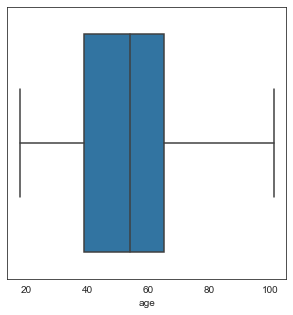

In [14]:
sns.boxplot(x=starbucks_final['age'])

<AxesSubplot:xlabel='income'>

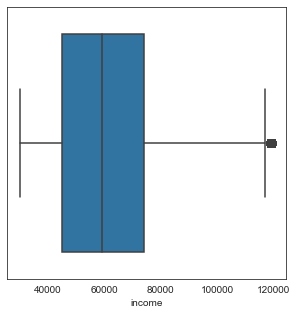

In [15]:
sns.boxplot(x=starbucks_final['income'])

<AxesSubplot:xlabel='income'>

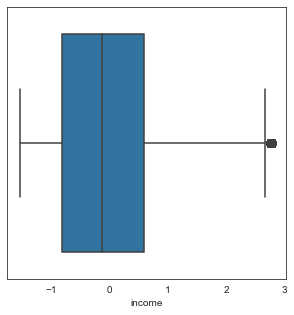

In [37]:
sns.boxplot(x=starbucks_std_final['income'])

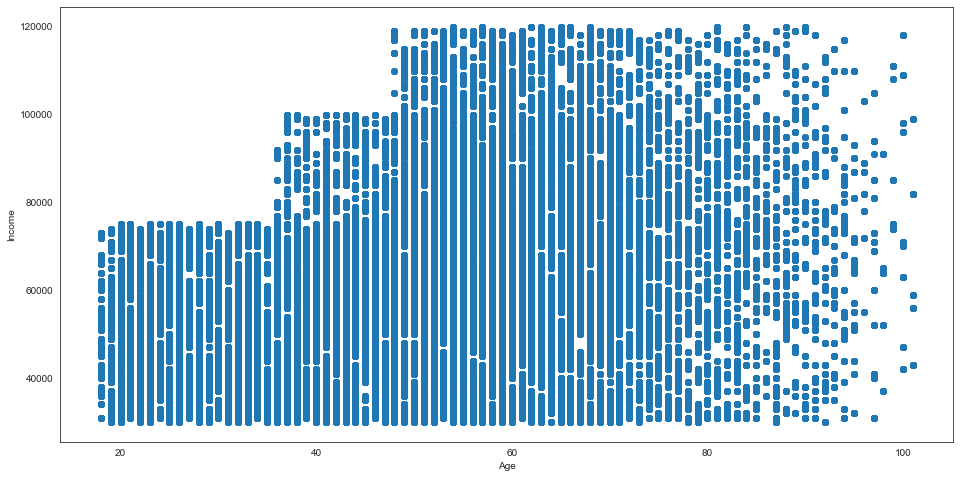

In [16]:
fig, ax = plt.subplots(figsize=(16,8))
ax.scatter(starbucks_final['age'], starbucks_final['income'])
ax.set_xlabel('Age')
ax.set_ylabel('Income')
plt.show()

In [17]:
starbucks_final.groupby('offer_received')['offer_viewed'].count()

offer_received
0    93055
1    54453
Name: offer_viewed, dtype: int64

## Functions for PCA

In [18]:
 def fit_pca(df, n_components,fit_trans = 'fit'):
    '''
    Uses sklearn.decomposition.PCA to fit a PCA model on "df".
    
    Parameters
    ----------
    df: A pandas.DataFrame. Comes from delta.csv.
    n_components: An int. Number of principal components to keep.
    
    Returns
    -------
    An sklearn.decomposition.pca.PCA instance.
    '''
    
    # YOUR CODE HERE
    pca = PCA(n_components= n_components)
    if fit_trans == 'fit':
        pca = pca.fit(df)
    else:
        pca = pca.fit_transform(df)
    
    #print(pca)
    return pca
def plot_scaled_variance(pca):
    '''
    Plots the variance explained by each of the principal components.
    Features are scaled with sklearn.StandardScaler.
    
    Parameters
    ----------
    pca: An sklearn.decomposition.pca.PCA instance.
    
    Returns
    -------
    A matplotlib.Axes instance.
    '''
    
    # YOUR CODE HERE
    fig, ax = plt.subplots(figsize=(10,6))
    ax.set_xlabel('Dimension #')
    ax.set_ylabel('Explained Variance Ratio')
    ax.set_title('Fraction of Explained Variance')
    ax.plot(pca.explained_variance_ratio_)
   
    return ax

def scree_plot(pca):
    '''
    Creates a scree plot associated with the principal components 
    
    INPUT: pca - the result of instantian of PCA in scikit learn
            
    OUTPUT:
            None
    '''
    num_components = len(pca.explained_variance_ratio_)
    ind = np.arange(num_components)
    vals = pca.explained_variance_ratio_
 
    plt.figure(figsize=(20, 6))
    ax = plt.subplot(111)
    cumvals = np.cumsum(vals)
    ax.bar(ind, vals)
    ax.plot(ind, cumvals)
#     for i in range(num_components):
#         ax.annotate(r"%s%%" % ((str(vals[i]*100)[:4])), (ind[i]+0.2, vals[i]), va="bottom", ha="center", fontsize=12)
 
    ax.xaxis.set_tick_params(width=0)
    ax.yaxis.set_tick_params(width=2, length=12)
 
    ax.set_xlabel("Principal Component")
    ax.set_ylabel("Variance Explained (%)")
    plt.title('Explained Variance Per Principal Component')
    

# Map weights for the first principal component to corresponding feature names
# and then print the linked values, sorted by weight.


def plot_weight(df, pca, ith) :
    '''
    plot weight for the i-th principal component to corresponding feature names
    Input : 
        df = original dataframe
        pca = pca.fit(data)
        ith = int value, from 1 to len(pca.n_components)
    Return : axes of barplot 
    '''
    sort_pca = sorted([(weight, label) for weight,label in zip(pca.components_[ith-1], df.columns) ])
    weights, features = zip(*sort_pca)
    weights, features = list(weights), list(features)
    fig, ax = plt.subplots(figsize=(10,20))
    ax = sns.barplot(weights, features)
    return ax

## Non-Standardized data shows one feature explain almost 100% of the variation. We should use Scaled data for dimension reduction

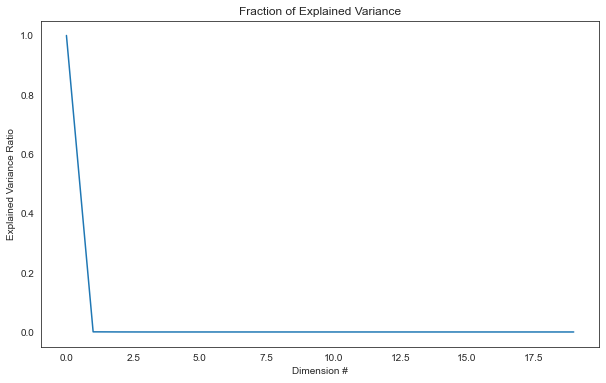

In [19]:
pca_fit = fit_pca(starbucks_final, starbucks_std_final.shape[1],'fit')
ax = plot_scaled_variance(pca_fit)

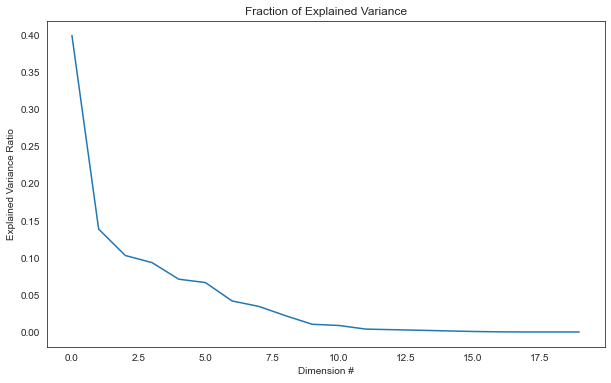

In [20]:
pca_fit = fit_pca(starbucks_std_final, starbucks_std_final.shape[1],'fit')
ax = plot_scaled_variance(pca_fit)

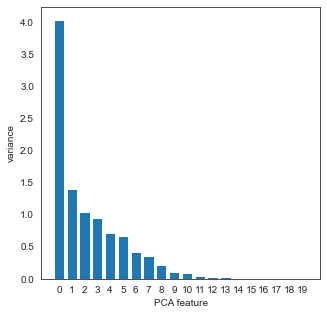

In [21]:
features = range(pca_fit.n_components_)
plt.bar(features, pca_fit.explained_variance_)
plt.xlabel('PCA feature')
plt.ylabel('variance')
plt.xticks(features)
plt.show()

Number of Main PCA components that explained at least 85% variance : 6
Number of Main PCA components that explained at least 90% variance : 7
Number of Main PCA components that explained at least 95% variance : 9


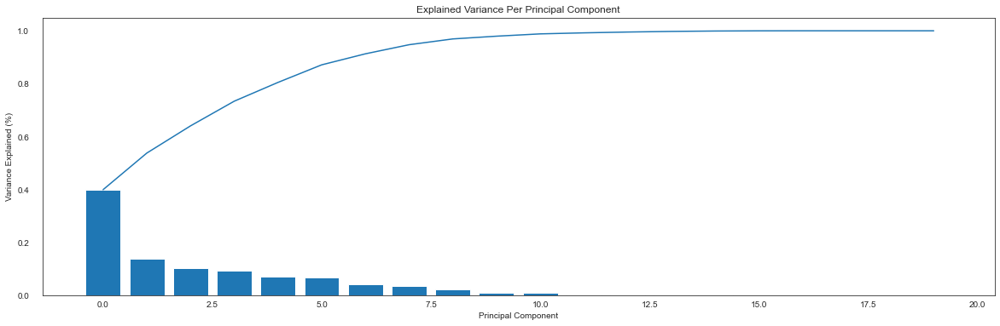

In [22]:
#scree plot 
scree_plot(pca_fit)

#PCA
# number of PCA components that explained at least 95% variance ==> 9 components
cumvals = np.cumsum(pca_fit.explained_variance_ratio_)
print("Number of Main PCA components that explained at least 85% variance : {}".format(np.where(cumvals >= 0.85)[0][0]+1))
print("Number of Main PCA components that explained at least 90% variance : {}".format(np.where(cumvals >= 0.90)[0][0]+1))
print("Number of Main PCA components that explained at least 95% variance : {}".format(np.where(cumvals >= 0.95)[0][0]+1))

## Setting Explained Variance Thershold of 90% and reduced the dataset to select 7 components

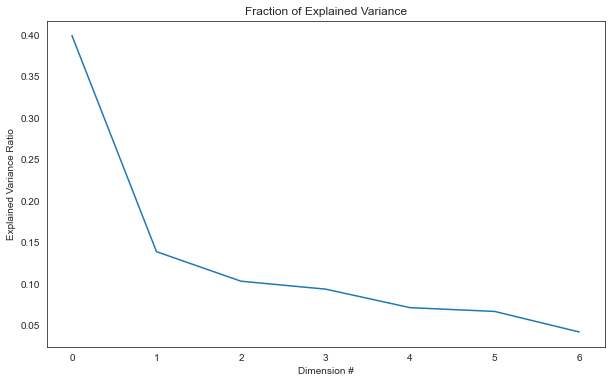

In [23]:
pca_fit_reduced = fit_pca(starbucks_std_final, 7)
ax = plot_scaled_variance(pca_fit_reduced)

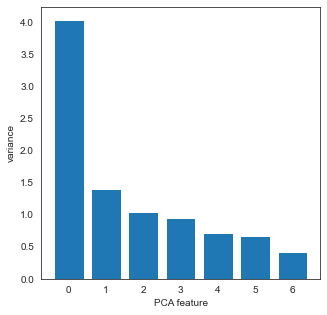

In [24]:
features = range(pca_fit_reduced.n_components_)
plt.bar(features, pca_fit_reduced.explained_variance_)
plt.xlabel('PCA feature')
plt.ylabel('variance')
plt.xticks(features)
plt.show()

Number of Main PCA components that explained at least 90% variance : 7


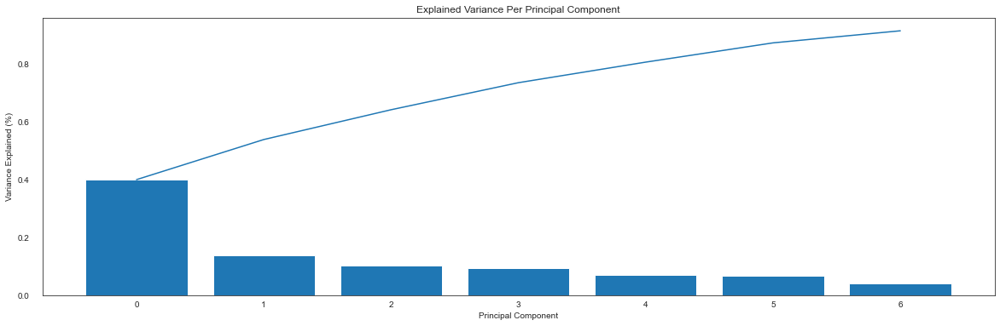

In [25]:
#scree plot 
scree_plot(pca_fit_reduced)

#PCA
# number of PCA components that explained at least 95% variance ==> 34 components
cumvals = np.cumsum(pca_fit_reduced.explained_variance_ratio_)
print("Number of Main PCA components that explained at least 90% variance : {}".format(np.where(cumvals >= 0.90)[0][0]+1))

In [26]:
pca_transform = fit_pca(starbucks_std_final, 7,"transform")

<AxesSubplot:>

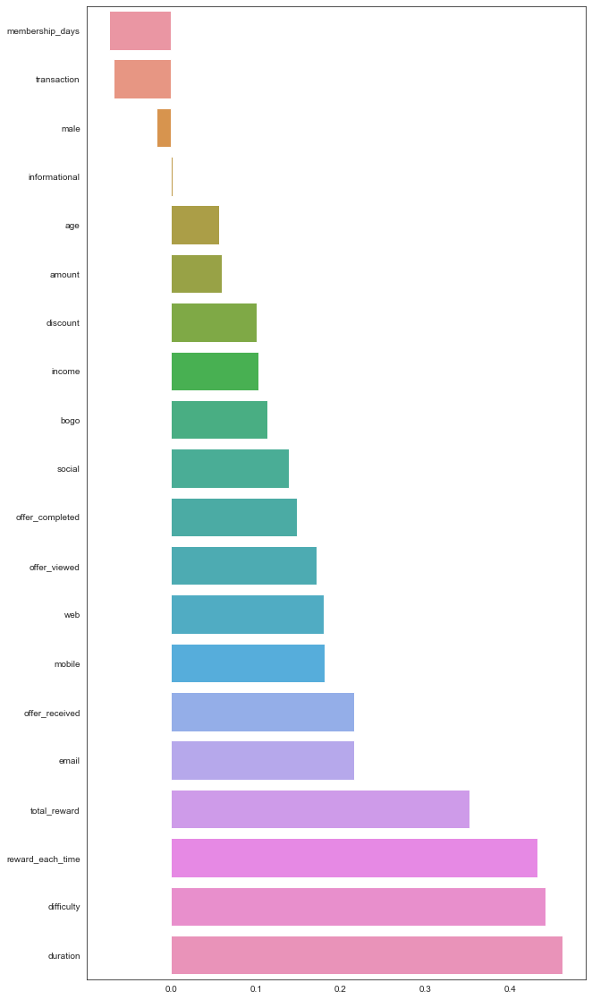

In [27]:
plot_weight(starbucks_std_final,pca_fit_reduced, 1 )

#Save the PCA Reduced dataset for later use for clustering 

In [28]:
np.save('starbucks_reduced.npy', pca_transform)

## Machine Learning Model - Unsupervised¶

### K-means

In [29]:
%matplotlib inline

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib as mpl
import matplotlib.pyplot as plt
import sklearn

from sklearn.utils import check_random_state
from sklearn.cluster import KMeans

In [30]:
def cluster(array, random_state, n_clusters=4):
    '''
    Fits and predicts k-means clustering on "array"
    
    Parameters
    ----------
    array: A numpy array
    random_state: Random seed, e.g. check_random_state(0)
    n_clusters: The number of clusters. Default: 4
    
    Returns
    -------
    A tuple (sklearn.KMeans, np.ndarray)
    '''
    kmeans = KMeans(n_clusters = n_clusters, init = 'k-means++', max_iter = 500, 
                n_init = 10, random_state = random_state)
    #fit the array,#Predict the clusters
    model = kmeans.fit(array)
    clusters = kmeans.predict(array)
    # Getting the cluster centers
    cluster_centroid = model.cluster_centers_
    #print(clusters) 
    #print(model)
    #print(kmeans)
    
    return model, clusters

def plot_inertia(array, start=1, end=10):
    '''
    Increase the number of clusters from "start" to "end" (inclusive).
    Finds the inertia of k-means clustering for different k.
    Plots inertia as a function of the number of clusters.

    
    Parameters
    ----------
    array: A numpy array.
    start: An int. Default: 1
    end: An int. Default: 10
    
    Returns
    -------
    A matplotlib.Axes instance.
    '''
    #Your code is here
    #    Increase the number of clusters from "start" to "end" (inclusive).
    #    Finds the inertia of k-means clustering for different k.
    
    #x_axis = range(start,end+1)
    x_axis = []
    inertia = []
    for i in range(start, end+1):
        kmeans = KMeans(n_clusters = i, init = 'k-means++',
                    max_iter = 400, n_init = 10, random_state = 0)
        kmeans.fit(array)
        inertia.append(kmeans.inertia_)
        x_axis.append(i)
    
    #Plots inertia as a function of the number of clusters.
    fig, ax = plt.subplots(figsize=(10,6))  
     
    ax.set_title('The elbow method')
    ax.set_ylabel('Inertia')
    ax.set_xlabel('Number of clusters')
    plt.plot(x_axis, inertia)
    
    return ax

def plot_pair(reduced, clusters):
    '''
    Uses seaborn.PairGrid to visualize the data distribution
    when axes are the first four principal components.
    Diagonal plots are histograms. The off-diagonal plots are scatter plots.
    
    Parameters
    ----------
    reduced: A numpy array. Comes from importing delta_reduced.npy
    
    Returns
    -------
    A seaborn.axisgrid.PairGrid instance.
    '''
    
    df = pd.DataFrame(reduced)
    df['c'] = clusters
    subset = [0,1,2,3, 'c']
    columns = [0,1,2,3]
    if clusters.any() == -1:
        # Black used for noise.
        color = 'k'
    
    ax = sns.PairGrid(df[subset], vars = columns, hue = 'c')
    ax = ax.map_diag(plt.hist)
    ax = ax.map_offdiag(plt.scatter)
    
    return ax

from sklearn.metrics import  silhouette_score
from tqdm import tqdm

def plot_silhouette(reduced, min_clusters =2, max_clusters =7):
    
    '''
    Uses seaborn.PairGrid to visualize the data distribution
    when axes are the first four principal components.
    Diagonal plots are histograms. The off-diagonal plots are scatter plots.
    
    Parameters
    ----------
    reduced: A numpy array. 
    min_clusters - Start with minimum cluster value
    max_clusters - maximum cluster value
    
    Returns
    -------
    A seaborn.axisgrid.PairGrid instance.
    '''
    silh = []
    clusters = range(min_clusters,max_clusters)
    for n in tqdm(clusters):

        model = KMeans(n_clusters = n, random_state=42)
        preds = model.fit_predict(reduced)

        silhouette_avg = silhouette_score(reduced, preds)

        silh.append(silhouette_avg)
        
        print("For n_clusters = ", n,"The avg silhouette_score is :", silhouette_avg)


    fig, ax = plt.subplots(figsize=(10,8))
    ax.plot(clusters, silh,marker="o")
    ax.set_ylabel("Silhoutte Score")
    ax.set_xlabel('number of clusters')


**Create Silhouette and Inertia Plot to identify the number of cluster to be considered for creating K means
Silhouette Coefficient:
Silhouette Coefficient or silhouette score is a metric used to calculate the goodness of a clustering technique. Its value ranges from -1 to 1.
1: Means clusters are well apart from each other and clearly distinguished.
0: Means clusters are indifferent, or we can say that the distance between clusters is not significant.
-1: Means clusters are assigned in the wrong way.

The Silhouette Coefficient is calculated using the mean intra-cluster distance (a) and the mean nearest-cluster distance (b) for each sample. The Silhouette Coefficient for a sample is (b - a) / max(a, b). To clarify, b is the distance between a sample and the nearest cluster that the sample is not a part of. Note that Silhouette Coefficient is only defined if number of labels is 2 <= n_labels <= n_samples - 1.

In short, the average silhouette approach measures the quality of a clustering. That is, it determines how well each object lies within its cluster. A high average silhouette width indicates a good clustering. The average silhouette method computes the average silhouette of observations for different values of k. The optimal number of clusters k is the one that maximizes the average silhouette over a range of possible values for k.2

100%|███████████████████████████████████████████████████████████████████████████████████| 5/5 [34:59<00:00, 419.96s/it]


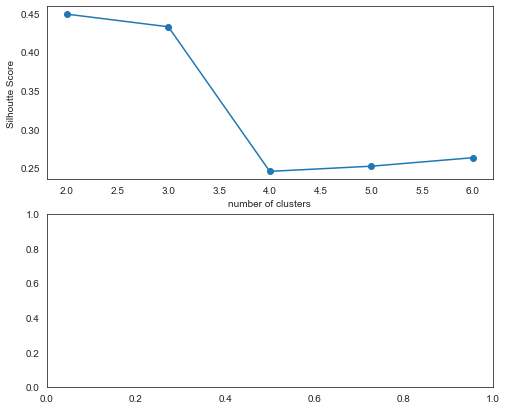

In [71]:
plot_silhouette(pca_transform)

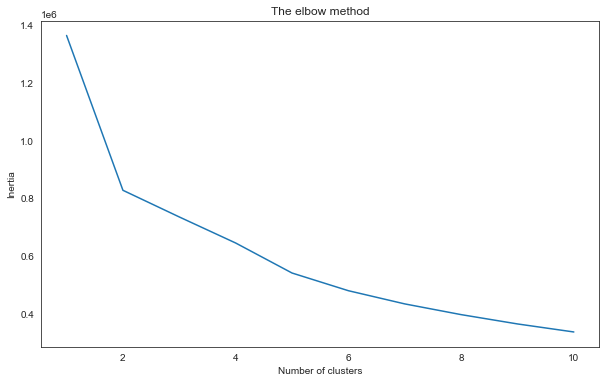

In [31]:
inertia = plot_inertia(pca_transform)

## Select Number of Clusters as 3 based on the Silhoutee Coeffecient and inertia from the Elbow method 

In [32]:
k_means_t, cluster_t = cluster(pca_transform, random_state=check_random_state(1), n_clusters=3)

####  Create a Dataframe with the actual data , PCA components and the cluster label for further analysis 

In [33]:
k_means_plot_df = pd.concat([starbucks_final.reset_index(drop=True),pd.DataFrame(pca_transform)], axis =1)
k_means_plot_df.columns.values[-7: ] = ['PCA_Component1', 'PCA_Component2', 'PCA_Component3', 'PCA_Component4', 'PCA_Component5', 'PCA_Component6', 'PCA_Component7',]
k_means_plot_df['Cluster'] = cluster_t
k_means_plot_df.groupby('Cluster').count()['transaction']

Cluster
0     36076
1    103829
2      7603
Name: transaction, dtype: int64

In [34]:
k_means_plot_df.head()

,offer_received,offer_viewed,offer_completed,transaction,transaction_time,amount,total_reward,age,income,male,membership_days,reward_each_time,difficulty,duration,email,mobile,social,web,bogo,discount,informational,PCA_Component1,PCA_Component2,PCA_Component3,PCA_Component4,PCA_Component5,PCA_Component6,PCA_Component7,Cluster
0,1,1.0,1.0,1.0,60.0,16.06,2.0,45,62000.0,0,608,2.0,10.0,10.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,2.761522,-0.572871,-0.027380,-0.050474,1.226504,0.490603,-0.315806,0
1,1,1.0,0.0,0.0,0.0,0.00,0.0,71,56000.0,1,158,2.0,10.0,10.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,2.511978,-0.647978,-1.838755,-0.557664,0.763667,1.343379,0.066954,0
2,1,1.0,1.0,1.0,393.0,14.00,4.0,71,73000.0,1,268,2.0,10.0,10.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,3.181194,0.441789,-0.941252,-0.255550,0.305441,0.585319,-0.491180,0
3,1,1.0,1.0,1.0,6.0,20.98,2.0,69,83000.0,0,1040,2.0,10.0,10.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,2.880437,0.890652,0.092174,-1.301546,1.318190,0.592364,-0.273894,0
4,1,1.0,1.0,1.0,168.0,15.16,2.0,59,93000.0,0,329,2.0,10.0,10.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,3.003813,0.712222,-1.036896,-0.189244,1.371429,-0.140478,-0.463522,0


In [35]:
starbucks_final.head()

,offer_received,offer_viewed,offer_completed,transaction,transaction_time,amount,total_reward,age,income,male,membership_days,reward_each_time,difficulty,duration,email,mobile,social,web,bogo,discount,informational
customer_id,,,,,,,,,,,,,,,,,,,,,
ffff82501cea40309d5fdd7edcca4a07,1,1.0,1.0,1.0,60.0,16.06,2.0,45,62000.0,0,608,2.0,10.0,10.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0
fff8957ea8b240a6b5e634b6ee8eafcf,1,1.0,0.0,0.0,0.0,0.00,0.0,71,56000.0,1,158,2.0,10.0,10.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0
fff7576017104bcc8677a8d63322b5e1,1,1.0,1.0,1.0,393.0,14.00,4.0,71,73000.0,1,268,2.0,10.0,10.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0
fff3ba4757bd42088c044ca26d73817a,1,1.0,1.0,1.0,6.0,20.98,2.0,69,83000.0,0,1040,2.0,10.0,10.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0
fff29fb549084123bd046dbc5ceb4faa,1,1.0,1.0,1.0,168.0,15.16,2.0,59,93000.0,0,329,2.0,10.0,10.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0


### Visualize the K-means Clusters

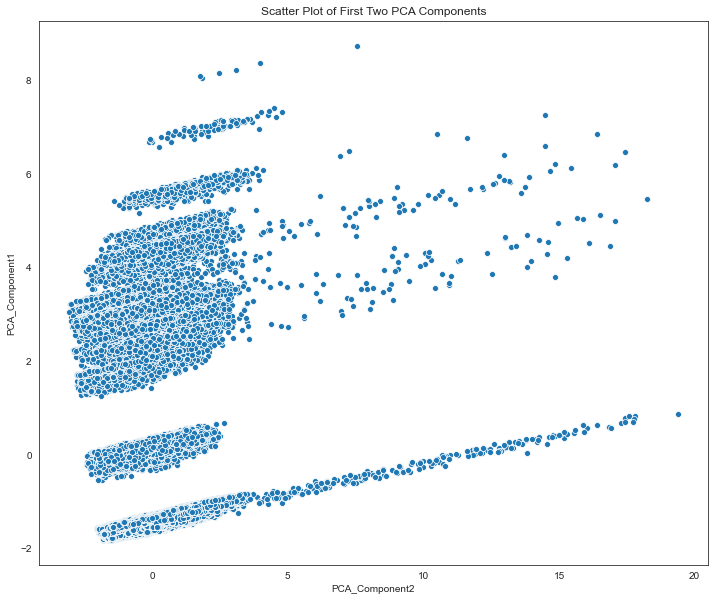

In [97]:
x_ax = k_means_plot_df['PCA_Component2']
y_ax = k_means_plot_df['PCA_Component1']

plt.figure(figsize = (12,10))
sns.scatterplot(x_ax,y_ax,palette = ['g','r','c'])
plt.title('Scatter Plot of First Two PCA Components')
plt.show()

In [103]:

#k_means_plot_df.loc[k_means_plot_df['Cluster'] ==0,['PCA_Component1']]

,PCA_Component1
0,2.761522
1,2.511978
2,3.181194
3,2.880437
4,3.003813
5,2.854607
6,3.109772
7,3.026913
8,2.961448
9,2.696017


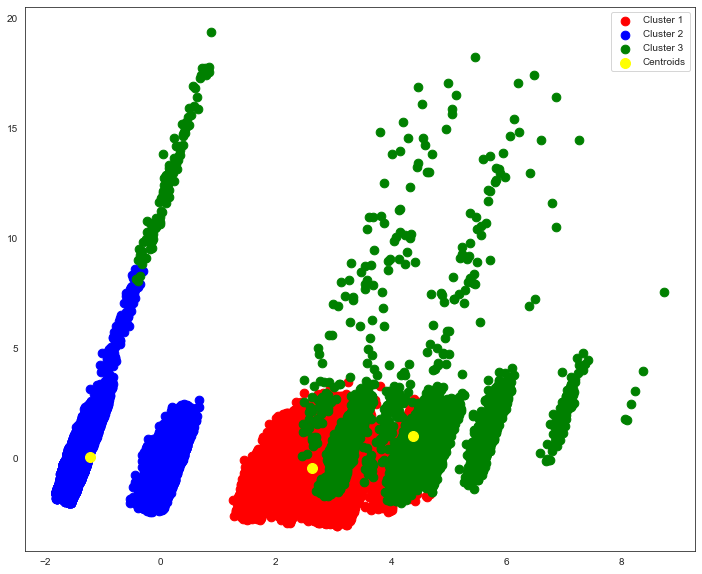

In [36]:
#Visualising the clusters
plt.figure(figsize = (12,10))
plt.scatter(k_means_plot_df.loc[k_means_plot_df['Cluster'] ==0,['PCA_Component1']], k_means_plot_df.loc[k_means_plot_df['Cluster'] ==0,['PCA_Component2']], s = 75, 
            c = 'red', label = 'Cluster 1')
plt.scatter(k_means_plot_df.loc[k_means_plot_df['Cluster'] ==1,['PCA_Component1']], k_means_plot_df.loc[k_means_plot_df['Cluster'] ==1,['PCA_Component2']], s = 75, 
            c = 'blue', label = 'Cluster 2')
plt.scatter(k_means_plot_df.loc[k_means_plot_df['Cluster'] ==2,['PCA_Component1']], k_means_plot_df.loc[k_means_plot_df['Cluster'] ==2,['PCA_Component2']], s = 75, 
            c = 'green', label = 'Cluster 3')

#Plotting the centroids of the clusters
plt.scatter(k_means_t.cluster_centers_[:, 0], 
            k_means_t.cluster_centers_[:, 1], s = 100, 
            c = 'yellow', label = 'Centroids')

plt.legend()

## DB SCAN

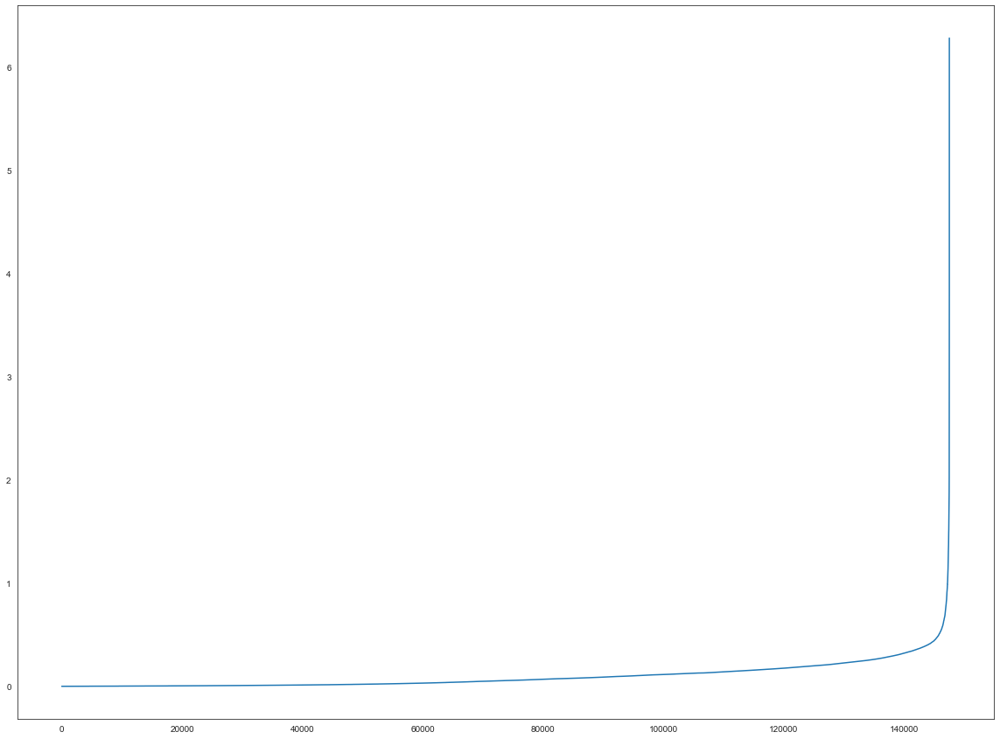

In [50]:
from sklearn.datasets.samples_generator import make_blobs
from sklearn.neighbors import NearestNeighbors
from sklearn.cluster import DBSCAN
from matplotlib import pyplot as plt
import seaborn as sns
from sklearn import metrics
#We can calculate the distance from each point to its closest neighbour using the NearestNeighbors. 
#The point itself is included in n_neighbors. 
neigh = NearestNeighbors(n_neighbors=3)
nbrs = neigh.fit(pca_transform)

#The kneighbors method returns two arrays, 
#one which contains the distance to the closest n_neighbors points 
#and the other which contains the index for each of those points.
distances, indices = nbrs.kneighbors(pca_transform)

#sort and plot results
plt.figure(figsize = (20,15))
distances = np.sort(distances, axis=0)
distances = distances[:,1]
plt.plot(distances)

In [51]:
dbsc = DBSCAN(eps = 0.8, min_samples = 20).fit(pca_transform)
#Get the cluster labels
labels = dbsc.labels_
###print (labels)
#Identify the core and border points
core_samples = np.zeros_like(labels, dtype = bool)
core_samples[dbsc.core_sample_indices_] = True

# Number of clusters in labels, ignoring noise if present.
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
n_noise_ = list(labels).count(-1)

print('Estimated number of clusters: %d' % n_clusters_)
print('Estimated number of noise points: %d' % n_noise_)
##print("Homogeneity: %0.3f" % metrics.homogeneity_score(y, labels))
#print("Completeness: %0.3f" % metrics.completeness_score(y, labels))
#print("V-measure: %0.3f" % metrics.v_measure_score(y, labels))
#print("Adjusted Rand Index: %0.3f"
#      % metrics.adjusted_rand_score(y, labels))
#print("Adjusted Mutual Information: %0.3f"
#      % metrics.adjusted_mutual_info_score(y, labels))
#print("Silhouette Coefficient: %0.3f"
#      % metrics.silhouette_score(X, labels))

Estimated number of clusters: 12
Estimated number of noise points: 1520


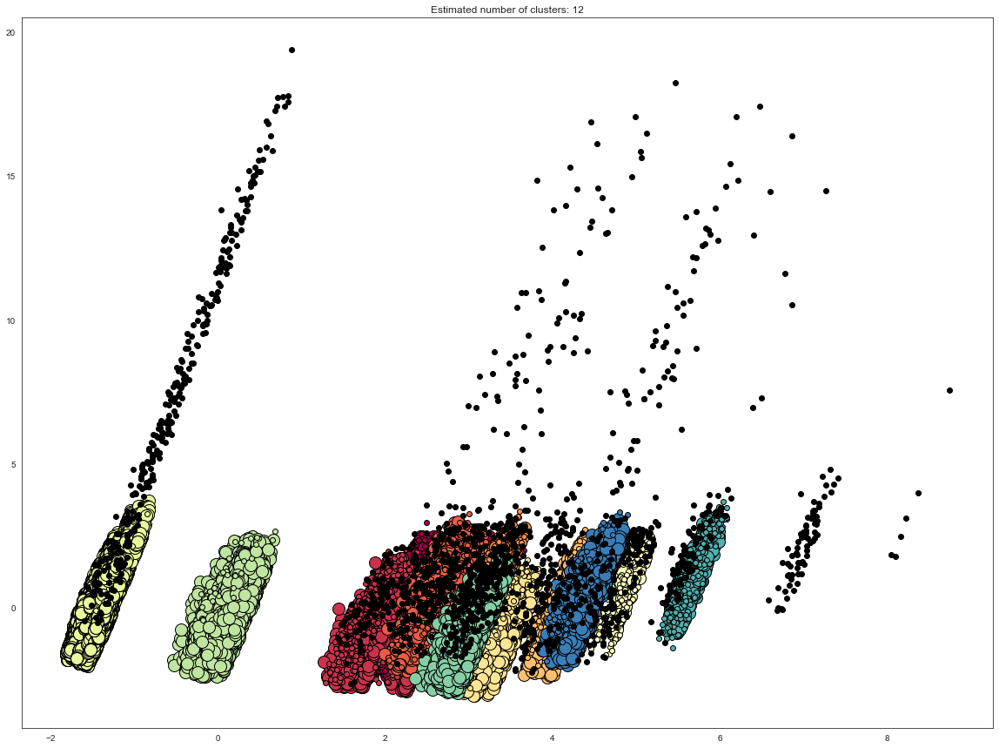

In [47]:
# Plot result
import matplotlib.pyplot as plt
plt.figure(figsize = (20,15))
# Black removed and is used for noise instead.
unique_labels = set(labels)
colors = [plt.cm.Spectral(each)
          for each in np.linspace(0, 1, len(unique_labels))]
for k, col in zip(unique_labels, colors):
    if k == -1:
        # Black used for noise.
        col = [0, 0, 0, 1]

    class_member_mask = (labels == k)

    xy = pca_transform[class_member_mask & core_samples]
    plt.plot(xy[:, 0], xy[:, 1], 'o', markerfacecolor=tuple(col),
             markeredgecolor='k', markersize=14)

    xy = pca_transform[class_member_mask & ~core_samples]
    plt.plot(xy[:, 0], xy[:, 1], 'o', markerfacecolor=tuple(col),
             markeredgecolor='k', markersize=6)

plt.title('Estimated number of clusters: %d' % n_clusters_)
plt.show()

# Cluster with TSNE

In [52]:

""" Visualise Cluster with TSNE"""
from sklearn.manifold import TSNE

tsne = TSNE(random_state=42,learning_rate=50).fit_transform(starbucks_std_final)

tsne_df = pd.DataFrame(tsne, columns=['xs', 'ys'])




<Figure size 1440x1080 with 0 Axes>

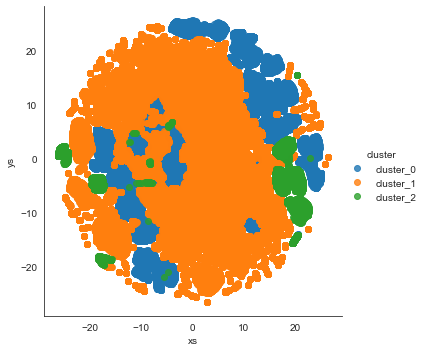

In [54]:
tsne_df = pd.DataFrame(tsne, columns=['xs', 'ys'])
tsne_df['cluster'] =  ['cluster_' + str(i) for i in cluster_t]

#plot tsne

plt.figure(figsize = (20,15))
#sns.scatterplot('xs','ys', hue='cluster', data=tsne_df, ax=ax, hue_order=['cluster_' + str(i) for i in range(0,7)])
ax.set_title("K means Cluster with TSNE")


sns.lmplot(x='xs', y='ys', data=tsne_df, hue='cluster', fit_reg=False,hue_order=['cluster_' + str(i) for i in range(0,3)])

#Pycaret - Unsupervised Model

In [ ]:
!pip install -q pycaret==2.0

In [23]:
#import clustering module

from pycaret.clustering import *

In [28]:
#intialize the setup
modeling_cluster_setup = setup(data = starbucks,
                           categorical_imputation = 'mode',
                           ignore_features = ['customer_id', 'offer_id','received_time','viewed_time','completed_time','time_viewed_received','time_completed_received','time_completed_viewed','transaction_time'],
                           normalize=True,normalize_method='zscore'#‘minmax’ ‘robust’ 
                           ,pca= True,pca_method='linear' #'kernel'
                           ,pca_components=0.85
                           ,remove_multicollinearity = True,multicollinearity_threshold = 0.85,
                           #handle_unknown_categorical = True,unknown_categorical_method = 'most_frequent',
                           )

Setup Succesfully Completed!


,Description,Value
0,session_id,3159
1,Original Data,"(147508, 29)"
2,Missing Values,False
3,Numeric Features,15
4,Categorical Features,14
5,Ordinal Features,False
6,High Cardinality Features,False
7,Transformed Data,"(147508, 6)"
8,Numeric Imputer,mean
9,Categorical Imputer,mode


#This function creates a model on the dataset passed as a data param during the setup stage. setup() function must be called before using create_model(). This function returns a trained model object. 

In [29]:
kmeans_model =create_model('kmeans', num_clusters = 4)

,Metric
Silhouette,0.2203
Calinski-Harabasz,43185.5859
Davies-Bouldin,1.2042


#Elbow plot

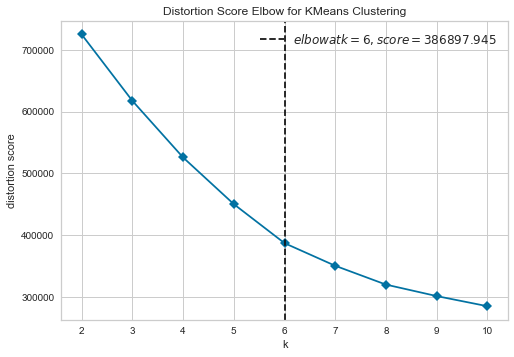

In [31]:
plot_model(kmeans_model, plot='elbow', label = True )

In [34]:
plot_model(kmeans_model, plot='silhouette', label = True )

ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.



Traceback (most recent call last):
  File "C:\Users\rsure\anaconda3\lib\site-packages\pycaret\clustering.py", line 3601, in plot_model
    visualizer.fit(X)
  File "C:\Users\rsure\anaconda3\lib\site-packages\yellowbrick\cluster\silhouette.py", line 147, in fit
    self.silhouette_samples_ = silhouette_samples(X, labels)
  File "C:\Users\rsure\anaconda3\lib\site-packages\sklearn\utils\validation.py", line 73, in inner_f
    return f(**kwargs)
  File "C:\Users\rsure\anaconda3\lib\site-packages\sklearn\metrics\cluster\_unsupervised.py", line 235, in silhouette_samples
    **kwds))
  File "C:\Users\rsure\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py", line 1622, in pairwise_distances_chunked
    D_chunk = reduce_func(D_chunk, sl.start)
  File "C:\Users\rsure\anaconda3\lib\site-packages\sklearn\metrics\cluster\_unsupervised.py", line 139, in _silhouette_reduce
    minlength=len(label_freqs))
  File "<__array_function__ internals>", line 6, in bincount
KeyboardInterrupt

During han

SystemExit: (Type Error): Plot Type not supported for this model.

#Description:

This function assigns each of the data point in the dataset passed during setup stage to one of the clusters using trained model object passed as model param. create_model() function must be called before using assign_model(). This function returns a pandas Dataframe.

In [32]:
kmeans_df = assign_model(kmeans_model, transformation = False)

#This function takes a trained model object and returns a plot on the dataset passed during setup stage. This function internally calls assign_model before generating a plot.

In [35]:
plot_model(kmeans_model, plot='cluster', label = False )

INFO:logs:Initializing plot_model()
INFO:logs:plot_model(model=KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
       n_clusters=4, n_init=10, n_jobs=-1, precompute_distances='deprecated',
       random_state=3159, tol=0.0001, verbose=0), plot=cluster, feature=None, label=False, save=False, system=True)
INFO:logs:Checking exceptions
INFO:logs:Importing libraries


INFO:logs:plot type: cluster
INFO:logs:SubProcess assign_model() called ==================================
INFO:logs:Initializing assign_model()
INFO:logs:assign_model(model=KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
       n_clusters=4, n_init=10, n_jobs=-1, precompute_distances='deprecated',
       random_state=3159, tol=0.0001, verbose=0), transformation=True, verbose=False)
INFO:logs:Checking exceptions
INFO:logs:Preloading libraries
INFO:logs:Copying data
INFO:logs:Transformation param set to True. Assigned clusters are attached on transformed dataset.
INFO:logs:Preparing display monitor
INFO:logs:Determining Trained Model
INFO:logs:Trained Model : K-Means Clustering
INFO:logs:(147508, 7)
INFO:logs:assign_model() succesfully completed......................................
INFO:logs:SubProcess assign_model() end ==================================
INFO:logs:Fitting PCA()
INFO:logs:Sorting dataframe
INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [36]:
plot_model(kmeans_model, plot='tsne', label = True )

INFO:logs:Initializing plot_model()
INFO:logs:plot_model(model=KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
       n_clusters=4, n_init=10, n_jobs=-1, precompute_distances='deprecated',
       random_state=3159, tol=0.0001, verbose=0), plot=tsne, feature=None, label=True, save=False, system=True)
INFO:logs:Checking exceptions
INFO:logs:Importing libraries


INFO:logs:plot type: tsne
INFO:logs:SubProcess assign_model() called ==================================
INFO:logs:Initializing assign_model()
INFO:logs:assign_model(model=KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
       n_clusters=4, n_init=10, n_jobs=-1, precompute_distances='deprecated',
       random_state=3159, tol=0.0001, verbose=0), transformation=True, verbose=False)
INFO:logs:Checking exceptions
INFO:logs:Preloading libraries
INFO:logs:Copying data
INFO:logs:Transformation param set to True. Assigned clusters are attached on transformed dataset.
INFO:logs:Preparing display monitor
INFO:logs:Determining Trained Model
INFO:logs:Trained Model : K-Means Clustering
INFO:logs:(147508, 7)
INFO:logs:assign_model() succesfully completed......................................
INFO:logs:SubProcess assign_model() end ==================================
INFO:logs:Fitting TSNE()


KeyboardInterrupt: 

# Cluster with TSNE

In [79]:
""" Visualise Cluster with TSNE"""
from sklearn.manifold import TSNE

tsne = TSNE(random_state=42).fit_transform(pca_transform)
tsne_df = pd.DataFrame(tsne, columns=['xs', 'ys'])
tsne_df['cluster'] = ['c_' + str(i) for i in preds_main]

#plot tsne
f,ax = plt.subplots(figsize=(10,8))
sns.scatterplot('xs','ys', hue='cluster', data=tsne_df, ax=ax, hue_order=['c_' + str(i) for i in range(0,9)])
ax.set_title("Main Cluster with TSNE")
#save fig
#f.savefig('main_tsne.png', dpi = 300)

KeyboardInterrupt: 

In [ ]:
dataset = pd.read_csv('data/seeds_dataset.csv')
#seeds=pd.read_csv("seeds_dataset.csv", usecols=[0,1,2,3,4,5,6])


seeds= dataset.iloc[:, [0,1, 2, 3, 4,5,6]].values

varieties=pd.read_csv("data/seeds_dataset.csv", usecols=[7])


#if we want to visualize after clustering use preds
#from sklearn.cluster import KMeans
# We build our model assuming three clusters
#k_means = KMeans(n_clusters=3, n_init=10)

# We fit our data to assign classes 
#k_means.fit(seeds)

# Obtain the predictions
#preds= k_means.predict(seeds)

#if we want to just to see dimension reduction please ignore above 
""" Visualise Cluster with TSNE"""
from sklearn.manifold import TSNE

tsne = TSNE(random_state=42,learning_rate=50).fit_transform(pca_transform)

tsne_df = pd.DataFrame(tsne, columns=['xs', 'ys'])
tsne_df['cluster'] = ['c_' + str(i) for i in clusters]

#plot tsne
f,ax = plt.subplots(figsize=(10,8))
sns.scatterplot('xs','ys', hue='cluster', data=tsne_df, ax=ax, hue_order=['c_' + str(i) for i in range(0,9)])
ax.set_title("Main Cluster with TSNE")


